# FuseMap Tutorial I: Integrating Spatial Transcriptomics Data Across Image-based Technologies

In this tutorial, we'll demonstrate how to use FuseMap to integrate spatial transcriptomics data from different imaging-based technologies (e.g., MERFISH and STARmap). We'll walk through the process step by step, explaining each component in detail.


## 1. Data preparation

We use spatial mouse brain atlases acquired using MERFISH and STARmap as example datasets. The data can be downloaded from:

- MERFISH data: Zhang et al. ([Nature paper](https://www.nature.com/articles/s41586-023-06808-9#data-availability))
- STARmap data: Shi et al. ([Nature paper](https://www.nature.com/articles/s41586-023-06569-5#data-availability))

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import os
import scanpy as sc
from easydict import EasyDict as edict
from fusemap import seed_all, ModelType, setup_logging
from fusemap.spatial_integrate import spatial_integrate
import logging
import pandas as pd
from time import time
seed_all(0)
start_time = time()

We recommend users to use the following default hyperparameters, but users can adjust according to their requirements.

## 2. Data preprocessing

In [3]:
# set paths to data
data_dir_list = [
    '/n/home11/mingzeyuan/FuseMap/data/02_imaging_sequencing_data/raw_data/merfish.h5ad',
    '/n/home11/mingzeyuan/FuseMap/data/02_imaging_sequencing_data/raw_data/starmap.h5ad'
]
output_dir = '/n/netscratch/nali_lab_seas/Everyone/mingze/FuseMap_imputation/workspace/integrate_merfish_starmap'
os.makedirs(output_dir, exist_ok=True)

Here users can specify `keep_celltype` and `keep_tissueregion` in arguments to filter to only keep specific cell types or tissue regions in the output results. # Empty string "" means keep all cell types or tissue regions.

In [4]:
args = edict(dict(output_save_dir=output_dir, 
                  keep_celltype="", 
                  keep_tissueregion="", 
                  use_llm_gene_embedding="false", 
                  pretrain_model_path=""))

In [5]:
setup_logging(args.output_save_dir)

arg_dict = vars(args)
dict_pd = {}
for keys in arg_dict.keys():
    dict_pd[keys] = [arg_dict[keys]]
pd.DataFrame(dict_pd).to_csv(os.path.join(args.output_save_dir, "config.csv"), index=False)
logging.info("\n\n\033[95mArguments:\033[0m \n%s\n\n", vars(args))
logging.info("\n\n\033[95mArguments:\033[0m \n%s\n\n", vars(ModelType))

2025-03-16 21:16:37,755 - INFO - 

Arguments: 
{'output_save_dir': '/n/netscratch/nali_lab_seas/Everyone/mingze/FuseMap_imputation/workspace/integrate_merfish_starmap', 'keep_celltype': '', 'keep_tissueregion': '', 'use_llm_gene_embedding': 'false', 'pretrain_model_path': ''}


2025-03-16 21:16:37,756 - INFO - 

Arguments: 
{'_generate_next_value_': <function Enum._generate_next_value_ at 0x1529a8f4c0d0>, '__module__': 'fusemap.config', '__doc__': 'An enumeration.', '_member_names_': ['pca_dim', 'hidden_dim', 'latent_dim', 'dropout_rate', 'n_epochs', 'learning_rate', 'optim_kw', 'use_input', 'lambda_ae_single', 'align_noise_coef', 'lr_patience_pretrain', 'lr_factor_pretrain', 'lr_limit_pretrain', 'patience_limit_final', 'lr_patience_final', 'EPS', 'TRAIN_WITHOUT_EVAL', 'USE_REFERENCE_PCT', 'verbose', 'use_key'], '_member_map_': {'pca_dim': <ModelType.pca_dim: 50>, 'hidden_dim': <ModelType.hidden_dim: 512>, 'latent_dim': <ModelType.latent_dim: 64>, 'dropout_rate': <ModelType.dropout_rat

FuseMap requires both gene expression data and spatial coordinates for each cell/spot as input. The spatial coordinates should be specified in the AnnData object's observation (obs) dataframe with columns "x" and "y".

For spatial transcriptomics data, the coordinates may be stored in different formats:
- As "row"/"col" columns in `data.obs`
- As spatial coordinates in `data.obsm["spatial"]` 
- Directly as "x"/"y" columns in `data.obs`

The code below handles these different formats and standardizes them to "x"/"y" columns in `data.obs`. This standardization is important for FuseMap to properly integrate the spatial information across datasets.

In [6]:
X_input = []
for ind, data_dir in enumerate(data_dir_list):
    print(f"Loading {data_dir}")
    data = sc.read_h5ad(data_dir)    
    # Handle spatial coordinates
    if "x" not in data.obs.columns:
        if "col" in data.obs.columns and "row" in data.obs.columns:
            data.obs["x"] = data.obs["col"]
            data.obs["y"] = data.obs["row"]
        elif "spatial" in data.obsm.keys():
            data.obs["x"] = data.obsm["spatial"][:,0]
            data.obs["y"] = data.obsm["spatial"][:,1]
        else:
            raise ValueError(f"Please provide spatial coordinates in the obs['x'] and obs['y'] columns for {data_dir}")
    
    # Add metadata
    data.obs['name'] = f'section{ind}'
    data.obs['file_name'] = os.path.basename(data_dir)
    print(f"Loaded {data.shape[0]} cells with {data.shape[1]} genes from {data.obs['file_name'].iloc[0]}")
    X_input.append(data)
    
# Set parameters for integration
kneighbor = ["delaunay"] * len(X_input)
input_identity = ["ST"] * len(X_input)
print(f"Loaded {len(X_input)} datasets")

Loading /n/home11/mingzeyuan/FuseMap/data/02_imaging_sequencing_data/raw_data/merfish.h5ad
Loaded 44959 cells with 1122 genes from merfish.h5ad
Loading /n/home11/mingzeyuan/FuseMap/data/02_imaging_sequencing_data/raw_data/starmap.h5ad
Loaded 43341 cells with 1022 genes from starmap.h5ad
Loaded 2 datasets


## 3. Data integration

In [7]:
spatial_integrate(X_input, args, kneighbor, input_identity)
print(f"Time elapsed: {(time() - start_time) / 60:.2f} min")

2025-03-16 21:16:49,768 - INFO - 

---------------------------------- Preprocess adata ----------------------------------

2025-03-16 21:16:54,667 - INFO - 

---------------------------------- Construct graph adata ----------------------------------

2025-03-16 21:16:55,014 - INFO - 

---------------------------------- Process graph adata ----------------------------------

2025-03-16 21:16:55,824 - INFO - 

number of genes in each section:[1104, 1022], Number of all genes: 1701.

2025-03-16 21:17:02,365 - INFO - 

---------------------------------- Phase 1. Pretrain FuseMap model ----------------------------------

  0%|          | 0/15 [00:00<?, ?it/s]

lambda_disc_single changed to 0.938573398016889


100%|██████████| 15/15 [03:46<00:00, 15.08s/it]
2025-03-16 21:20:48,498 - INFO - 

File name changed in the end

2025-03-16 21:20:48,499 - INFO - 

---------------------------------- Phase 2. Evaluate pretrained FuseMap model ----------------------------------

100%|██████████| 703/703 [00:08<00:00, 78.58it/s]
2025-03-16 21:20:57,529 - INFO - 

---------------------------------- Phase 3. Estimate_balancing_weight ----------------------------------

2025-03-16 21:23:04,695 - INFO - 

---------------------------------- Phase 4. Train final FuseMap model ----------------------------------

100%|██████████| 15/15 [04:05<00:00, 16.38s/it]
2025-03-16 21:27:10,347 - INFO - 

File name changed in the end

2025-03-16 21:27:10,348 - INFO - 

---------------------------------- Phase 5. Evaluate final FuseMap model ----------------------------------

100%|██████████| 703/703 [00:06<00:00, 113.63it/s]
2025-03-16 21:27:16,677 - INFO - 

---------------------------------- Finish ---------------------

## 4. Visualization

### read single-cell embedding

Text(0.5, 1.0, 'Single-cell embedding, colored by sample ID')

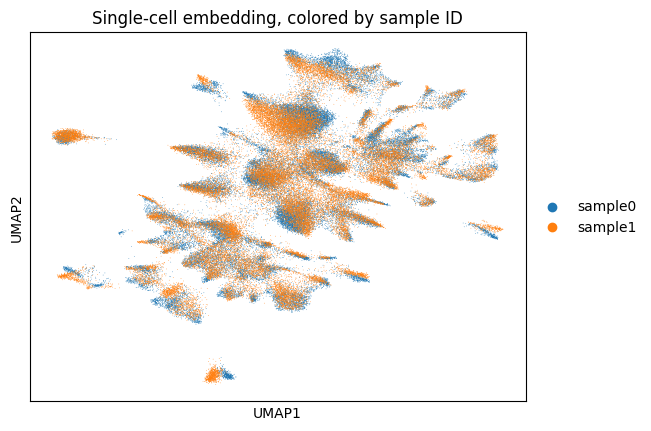

In [8]:
ad_embed=sc.read_h5ad(os.path.join(output_dir, 'ad_celltype_embedding.h5ad'))
sc.pp.neighbors(ad_embed, n_neighbors=50,use_rep='X')
sc.tl.umap(ad_embed)
ax = sc.pl.umap(ad_embed,color='batch',size=1, show=False)
ax.set_title('Single-cell embedding, colored by sample ID')

### read spatial embedding

Text(0.5, 1.0, 'Spatial embedding, colored by sample ID')

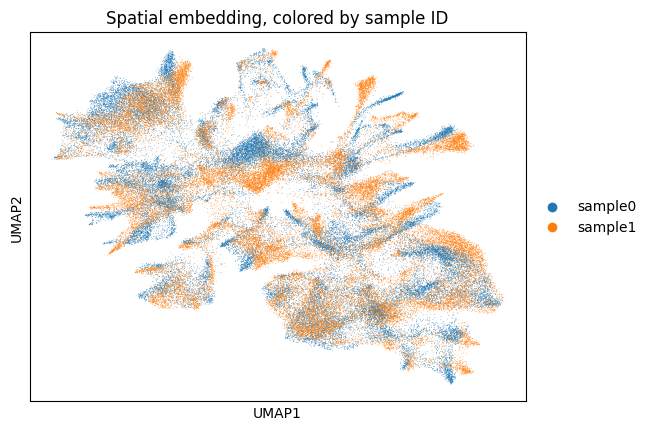

In [9]:
ad_embed=sc.read_h5ad(os.path.join(output_dir, 'ad_tissueregion_embedding.h5ad'))
sc.pp.neighbors(ad_embed, n_neighbors=50,use_rep='X')
sc.tl.umap(ad_embed)
ax = sc.pl.umap(ad_embed,color='batch',size=1, show=False)
ax.set_title('Spatial embedding, colored by sample ID')

### read gene embedding

Text(0.5, 1.0, 'Gene embedding, colored by sample ID')

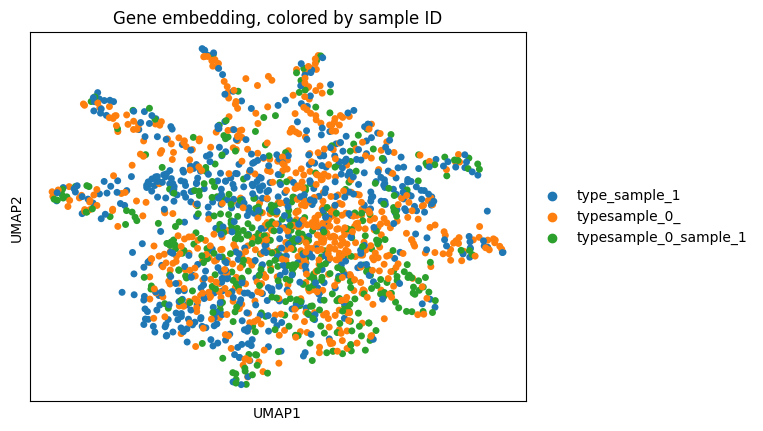

In [10]:
ad_embed=sc.read_h5ad(os.path.join(output_dir, 'ad_gene_embedding.h5ad'))
sc.pp.neighbors(ad_embed, n_neighbors=50,use_rep='X')
sc.tl.umap(ad_embed)
ax = sc.pl.umap(ad_embed,color='type', size=100,show=False)
ax.set_title('Gene embedding, colored by sample ID')

## 5. Transfer cell types (or tissue regions)

In this part, we aim to transfer the cell types from STARmap to merfish. We achieve this by learning a classifier on the cell type embedding space according to the cell type annotations from STARmap. You can modify the `cell_type_index` to tissue region index to transfer tissue region annotations.

In [4]:
from fusemap.utils import NNTransferTrain, NNTransfer, NNTransferPredictWithUncertainty
import torch
from sklearn import preprocessing
from torch.utils.data import DataLoader, TensorDataset
from torch.utils.data import random_split
from torch import optim, nn
import sklearn
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# open cell type embedding
ad_fusemap_emb = sc.read_h5ad(os.path.join(output_dir, 'ad_celltype_embedding.h5ad'))
cell_type_index = 'gt_cell_type_main'

In [ ]:
ad_embed_train = ad_fusemap_emb[ad_fusemap_emb.obs.loc[ad_fusemap_emb.obs[cell_type_index]!='nan'].index]
ad_embed_train = ad_embed_train[ad_embed_train.obs[cell_type_index]!='Unannotated',:]

In [6]:
sample1_embeddings = ad_embed_train.X
sample1_labels = list(ad_embed_train.obs[cell_type_index])

le = preprocessing.LabelEncoder()
le.fit(sample1_labels)

sample1_labels = le.transform(sample1_labels)
sample1_labels = sample1_labels.astype('str').astype('int')

dataset1 = TensorDataset(torch.Tensor(sample1_embeddings), torch.Tensor(sample1_labels).long())
train_size = int(0.8 * len(dataset1))  # Use 80% of the data for training
val_size = len(dataset1) - train_size
train_dataset, val_dataset = random_split(dataset1, [train_size, val_size])

val_size = int(0.5 * len(val_dataset))  # Use 10% of the data for val and 10% for testing 
test_size = len(val_dataset) - val_size
val_dataset, test_dataset = random_split(val_dataset, [val_size, test_size])

In [7]:
train_loader = DataLoader(train_dataset, batch_size=256, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=256, shuffle=False)
test_loader = DataLoader(test_dataset, batch_size=256, shuffle=False)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
class_weight = torch.Tensor(sklearn.utils.class_weight.compute_class_weight(class_weight='balanced',
                                                                            classes=np.unique(sample1_labels),
                                                                            y=sample1_labels))
model = NNTransfer(input_dim=sample1_embeddings.shape[1],
                   output_dim=len(np.unique(sample1_labels)))
model.to(device)  # Move the model to GPU if available
criterion = nn.CrossEntropyLoss(weight=class_weight.to(device))
optimizer = optim.Adam(model.parameters(), lr=0.001)

NNTransferTrain(model, criterion, optimizer, train_loader, val_loader, device)

Epoch 0/200 - Train Loss: 2.8635384130083823, Accuracy: 90.04910829671749
Epoch 1/200 - Train Loss: 2.5025686803928093, Accuracy: 90.79865598345826
Epoch 12/200 - early stopping due to patience count


In [8]:
test_predictions,sample2_uncertainty = NNTransferPredictWithUncertainty(model, test_loader, device)
test_predictions = le.inverse_transform(test_predictions)

all_labels = [label.item() for _, label in test_dataset]


gt_test_predictions = le.inverse_transform(all_labels)

GT_starmap_s = gt_test_predictions
PRED_starmap_s = test_predictions

In [9]:
cross_tab = pd.crosstab(pd.Series(GT_starmap_s, name='Original'),
                                pd.Series(PRED_starmap_s, name='FuseMap'))

cross_tab_normalized = cross_tab.div(cross_tab.sum(axis=0), axis=1)
cross_tab_normalized = cross_tab_normalized.div(cross_tab_normalized.sum(axis=1), axis=0)

cross_tab_normalized = cross_tab_normalized*100
cross_tab_normalized = np.around(cross_tab_normalized)
cross_tab_normalized=cross_tab_normalized.astype('int')

In [10]:
cross_tab_normalized.shape

(22, 20)

In [11]:
sort_list = ['Vascular and leptomeningeal cells',
    'Telencephalon inhibitory interneurons',
    'Microglia',
    'Astrocytes',
    'Telencephalon projecting excitatory neurons',
    'Telencephalon projecting inhibitory neurons',
    'Perivascular macrophages',
    'Vascular smooth muscle cells',
    'Oligodendrocyte precursor cells',
    'Oligodendrocytes',
    'Cholinergic and monoaminergic neurons',
    'Di- and mesencephalon excitatory neurons',
    'Ependymal cells',
    'Hindbrain neurons',
    'Dentate gyrus granule neurons',
    'Olfactory inhibitory neurons',
    'Di- and mesencephalon inhibitory neurons',
    'Glutamatergic neuroblasts',
    'Peptidergic neurons',
    'Choroid epithelial cells',]

cross_tab_normalized = cross_tab_normalized[sort_list]
cross_tab_normalized = cross_tab_normalized.loc[sort_list]
cross_tab_normalized.shape

(20, 20)

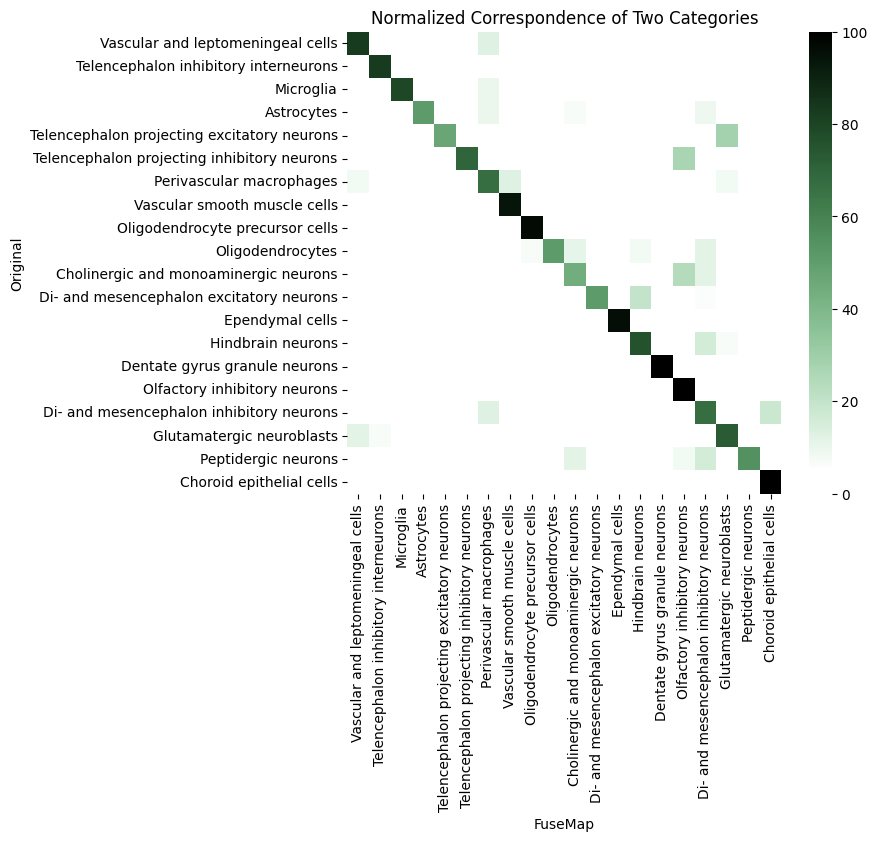

In [12]:
cmap = sns.cubehelix_palette(start=2, rot=0, dark=0, light=1.05, reverse=False, as_cmap=True)

# Plot heatmap
plt.figure(figsize=(7,6))
ax=sns.heatmap(cross_tab_normalized, cmap=cmap,)
plt.title("Normalized Correspondence of Two Categories")
# plt.savefig('figures_refine/main_ct_starmap.png',dpi=300, transparent=True)
plt.show()

Transfer to all cells

In [13]:
sample2_embeddings = ad_fusemap_emb.X
dataset2 = TensorDataset(torch.Tensor(sample2_embeddings))
dataloader2 = DataLoader(dataset2, batch_size=256, shuffle=False)
sample2_predictions, sample2_uncertainty = NNTransferPredictWithUncertainty(model, dataloader2, device)
sample2_predictions = le.inverse_transform(sample2_predictions)

ad_fusemap_emb.obs['transfer_gt_cell_type_main'] = sample2_predictions

In [14]:
ad_fusemap_new = ad_fusemap_emb[ad_fusemap_emb.obs['batch'].isin(['sample0'])]
cell_types = sorted(ad_fusemap_new.obs['transfer_gt_cell_type_main'].unique())

# Generate unique colors using a continuous colormap
num_colors = len(cell_types)
cmap = plt.get_cmap('gist_rainbow', num_colors)  # 'gist_rainbow' ensures distinct colors
colors = [cmap(i / num_colors) for i in range(num_colors)]

# Create a dictionary mapping tissue types to colors
colormap = dict(zip(cell_types, colors))

In [15]:
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (8, 8)
plt.rcParams['figure.dpi'] = 300

# Get coordinates for both samples
x1 = pd.to_numeric(ad_embed_train.obs['x'], errors='coerce')
y1 = pd.to_numeric(ad_embed_train.obs['y'], errors='coerce')
x2 = pd.to_numeric(ad_fusemap_new.obs['x'], errors='coerce')
y2 = pd.to_numeric(ad_fusemap_new.obs['y'], errors='coerce')

# Calculate centroids
centroid1 = (np.mean(x1), np.mean(y1))
centroid2 = (np.mean(x2), np.mean(y2))

# Center both point sets
x1_centered = x1 - centroid1[0]
y1_centered = y1 - centroid1[1]
x2_centered = x2 - centroid2[0]
y2_centered = y2 - centroid2[1]

# Calculate scale factors to normalize both point sets
scale1 = np.sqrt(np.mean(x1_centered**2 + y1_centered**2))
scale2 = np.sqrt(np.mean(x2_centered**2 + y2_centered**2))

# Scale points to have same spread
x1_normalized = x1_centered / scale1
y1_normalized = y1_centered / scale1
x2_normalized = x2_centered / scale2
y2_normalized = y2_centered / scale2

# Calculate principal components for rotation alignment
coords1 = np.column_stack((x1_normalized, y1_normalized))
coords2 = np.column_stack((x2_normalized, y2_normalized))

# Create a figure with subplots for each tissue type (2 plots per tissue)
n_tissues = len(cell_types)
n_cols = 4
n_rows = (2 * n_tissues + n_cols - 1) // n_cols  # Double the rows since we need 2 plots per tissue
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 5*n_rows), dpi=300)
axes = axes.flatten()

# Plot each tissue type separately in consecutive subplots
for idx, tissue in enumerate(cell_types):
    # First subplot for Sample 1
    ax1 = axes[2*idx]
    # Plot background cells first with high transparency
    mask1_bg = ad_embed_train.obs['gt_cell_type_main'] != tissue
    ax1.scatter(coords1[mask1_bg, 0], coords1[mask1_bg, 1], s=0.3,
              c='lightgray', alpha=0.1)
    # Plot cells of current tissue type
    mask1 = ad_embed_train.obs['gt_cell_type_main'] == tissue
    ax1.scatter(coords1[mask1, 0], coords1[mask1, 1], s=0.3, 
              c=[colormap[tissue]], label='Sample 1')
    ax1.set_title(f'{tissue} - Reference')
    ax1.axis('off')
    # ax1.invert_yaxis()
    
    # Second subplot for Sample 2
    ax2 = axes[2*idx + 1]
    # Plot background cells first with high transparency
    mask2_bg = ad_fusemap_new.obs['transfer_gt_cell_type_main'] != tissue
    ax2.scatter(coords2[mask2_bg, 0], coords2[mask2_bg, 1], s=0.3,
              c='lightgray', alpha=0.1)
    # Plot cells of current tissue type
    mask2 = ad_fusemap_new.obs['transfer_gt_cell_type_main'] == tissue
    ax2.scatter(coords2[mask2, 0], coords2[mask2, 1], s=0.3,
              c=[colormap[tissue]], label='Sample 2')
    ax2.set_title(f'{tissue} - Transferred')
    ax2.axis('off')
    # ax2.invert_xaxis()
    # ax2.invert_yaxis()
    
# plot all cells with light gray

# Remove any empty subplots
for idx in range(2*n_tissues, len(axes)):
    fig.delaxes(axes[idx])

plt.tight_layout()
# plt.savefig('mouse_embryo_trasnsfer_by_tissue.png', dpi=300, bbox_inches='tight')
plt.show()
